#Proyecto Aplicado Big Data
## Módulo 3
### Características Geológicas y Geomorfológicas de Litoral Caribe Colombiano
---
## Giovanny Alejandro Cuervo Londoño

## 1. Propuesta
---
Es necesario evaluar el litoral del Caribe Colombiano en términos de características geológicas como tipos de depósitos y geomorfología asociada, con el objetivo de interpretar las dinámicas costeras y otros procesos morfodinámicos, esto constituye la línea base para la generación de conocimiento que contribuya a la toma de decisiones por parte de actores estatales, población civil y entes privados. Por esto, es importante caracterizar las líneas de costa realizando una recopilación de las bases de datos relacionadas para realizar un tratamiento de datos con tecnologías Big Data.

Por lo tanto este proyecto plantea la adquisición de 3 conjuntos de datos de la base de datos <a href=http://geonodesiam.invemar.org.co/>SIAM</a> del INVEMAR; dispuestos por la Dirección de Asuntos Marinos, Costeros y Recursos Acuáticos (DAMCRA) del Ministerio de Ambiente y Desarrollo Sostenible, dichos datos corresponden a: Tipos de Costas, Mapa Geomorfológico del caribe colombiano y Facies. Para posteriormente ser cargados como documentos .json una base de datos *stand alone* basada en documentos (**MongoDB**), esto por medio del API **Pymongo**, el cual nos permite interactuar con estas tecnologías *Big Data* por medio de Notebooks interactivos de Python.

Finalmente se pretende proponer una serie de query o peticiones a dicha base de datos, junto con algunas gráficos para responder las siguientes preguntas:

1. Desde el punto de vista sedimentológico y litológico, ¿Qué características son relevantes y particulares de la línea litoral del Caribe Colombiano?

2. ¿Cuales son las Unidades Geomorfológicas más relevantes de la Costa Caribe Colombiana?

3. ¿Cuales son las litofacies predominantes de la plataforma proximal del Caribe colombiano?


### 1.1 Instalación de Herramientas
---
Para la realización de este proyecto se usaron los módulos de python: Pymongo y Pandas para el manejo y visualización de la base de datos, request y json para la obtención y formato de los datos y finalmente Plotly para la visualización geográfica del conjunto de datos.

In [ ]:
# Actualizamos el repositorio e instalamos mongodb.
!sudo apt -qq update
!sudo apt -qq install -y mongodb

70 packages can be upgraded. Run 'apt list --upgradable' to see them.
mongodb is already the newest version (1:3.6.3-0ubuntu1.1).
0 upgraded, 0 newly installed, 0 to remove and 70 not upgraded.


In [ ]:
# Creamos los directorios 'data' y 'log'.
!mkdir -p data log

# Ejecutamos el servicio de Mongo.
!mongod --dbpath ./data --logpath ./log/mongod.log --fork

about to fork child process, waiting until server is ready for connections.
forked process: 10309
ERROR: child process failed, exited with error number 100
To see additional information in this output, start without the "--fork" option.


In [ ]:
# Importamos pymongo
import pymongo
import pandas as pd
import requests
import json 

In [ ]:
# Versiones de las librerías usadas.
!python --version
print('PyMongo', pymongo.__version__)
print('Pandas', pd.__version__)
print('Requests', requests.__version__)
print('json', json.__version__)

Python 3.7.10
PyMongo 3.11.4
Pandas 1.1.5
Requests 2.23.0
json 2.0.9


## 2. Declaración del Conjunto de Datos
---

### 2.1 Obtención de los Datos
---
Desde el servidor de la base de datos SIAM del invemar fueron solicitados y cargados los 3 documentos .json a nuestro entorno de trabajo Colab. dichos documentos fueron contenidos en un diccionario de python de forma temporal. La obtención de estos datos fue realizada mediante los módulos de python ```request``` y ```json```.

In [ ]:
#importamos el archivo .json desde la base de datos SIAM
link1 = 'http://geonodesiam.invemar.org.co/geoserver/wfs?srsName=EPSG%3A4326&typename=geonode%3Atipos_de_costa&outputFormat=json&version=1.0.0&service=WFS&request=GetFeature'
link2 = 'http://geonodesiam.invemar.org.co/geoserver/wfs?srsName=EPSG%3A4326&typename=geonode%3Ageomorfologia_4&outputFormat=json&version=1.0.0&service=WFS&request=GetFeature'
link3 = 'http://geonodesiam.invemar.org.co/geoserver/wfs?srsName=EPSG%3A4326&typename=geonode%3Afacies_1&outputFormat=json&version=1.0.0&service=WFS&request=GetFeature'
links = [link1, link2, link3]
for i, item in enumerate(links):
  html = requests.get(item, allow_redirects=True)
  json_file = html.json()
  json_file = str(json_file).replace("\'", "\"")
  #guardamos el documento .json
  with open(f'carib_{i+1}.json', 'w') as f:
    f.write(json_file)

In [ ]:
#cargamos el documento .json en la variable carib_1
docs = {}
for i in range(len(links)):
  with open(f'/content/carib_{i+1}.json') as f:
    docs[f'carib_{i+1}'] = json.load(f)



### 2.2 Descripción del conjunto de datos
---
Los conjuntos de datos seleccionados son de tipo semiestructurado y cuentan con un formato tipo .json, dicho formato sigue le modelo Clave-Valor donde un conjunto de parejas de este tipo conforma un documento y un conjunto de documentos constituye una colección, utilizando el módulo request y json se pudo obtener los datos. 

Estos documentos presentan cuatro claves principales: ```"type"```, ```"totalFeatures"```, ```"features"``` y ```"crs"```; de las cuales "type", "totalFeatures" y "crs" contienen valores relacionados con el documento, es decir el *sistema geodésico de coordenadas geográficas* (src), *cantidad de geometrías* (totalFeatures) entre otras, mientras que la clave "features" contiene exclusivamente cada una de los *objetos* de interés. 

Dichos documentos .json tienen la siguiente estructura:


```
{
  "type": "FeatureCollection", 
  "totalFeatures": 296,
  "features":{
              "geometry": {
                            "coordinates": [...],
              "type": "..."},
              "geometry_name": "the_geom",
              "id": "...",
              "properties": {
                              "ET_Length": 1.01586,
                              "OBJECTID": 5,
                              "Shape_Leng": 1015.83628006,
                              "geologico": "...",
                              "geomorf": "..."
                            },
              "type": "Feature"
              }, 
  "crs":{
          "properties": {
                          "name": "urn:ogc:def:crs:EPSG::4326"
                        },
          "type": "name"
        }
}

```

#### 2.2.1 Dataset: Tipos de costas
---
En este conjunto de datos se encuentra información relacionada con los materiales térreos litificados y no litificados junto con su clasificación según el tipo de costa, de acuerdo a su composición y tipo de material de la línea litoral del caribe colombiano. Esta información es obtenida a partir de los mapas geológicos departamentales y planchas 1:100.000 de Ingeomias y el mapa Geomorfológico actualizado de los diferentes estudios realizados.

In [ ]:
#asignamos el archivo .json a una variable
carib_1 = docs['carib_1']

In [ ]:
#observamos que cuando es cargado este llega como un diccionario de python
print(f'tipo de archivo: {type(carib_1)}')

tipo de archivo: <class 'dict'>


In [ ]:
carib_1.keys()

dict_keys(['type', 'totalFeatures', 'features', 'crs'])

In [ ]:
#la clave principal 'features' es una lista que contiene los objetos de interes
print(f"Tipo de valor contenido en carib_1['features']: {type(carib_1['features'])}")
print(f"Cantidad de objetos contenidos en carib_1['features']: {len(carib_1['features'])}")

Tipo de valor contenido en carib_1['features']: <class 'list'>
Cantidad de objetos contenidos en carib_1['features']: 296


Inspeccionando la clave principal "crs", correspondiente al *sistema de coordenadas de referencia* vemos que este corresponde al **World Geodetic System 1984** cuyas unidades de medida corresponde a grados:

<a href="https://epsg.io/4326"> EPSG: 4326 </a>

```
Unit: degree (supplier to define representation)

Geodetic CRS: WGS 84

Datum: World Geodetic System 1984

Ellipsoid: WGS 84

Prime meridian: Greenwich
Data source: OGP

Information source: EPSG. See 3D CRS for original information source.

Revision date: 2007-08-27
```

In [ ]:
#inspeccionamos los valores contenidos en la clave "crs"
carib_1['crs']

{'properties': {'name': 'urn:ogc:def:crs:EPSG::4326'}, 'type': 'name'}

In [ ]:
#inspeccionamos los valores contenids en la clave "totalFeatures"
carib_1['totalFeatures']

296

In [ ]:
#inspeccionamos por ejemplo el 5to objeto contenido en la clave 'features'
carib_1['features'][4]

{'geometry': {'coordinates': [[[-75.22580120985984, 10.799284544846238],
    [-75.22565226782159, 10.799333679637611],
    [-75.22485958829526, 10.79973770522066],
    [-75.22404996104761, 10.800193764977578],
    [-75.22329296672068, 10.800667705444207],
    [-75.2226952023059, 10.801245000955019],
    [-75.22213286531492, 10.801823295116069],
    [-75.22160627494587, 10.802487324934162],
    [-75.22116761368578, 10.80313521084863],
    [-75.22086961686169, 10.80365942576295],
    [-75.22048448293025, 10.80441105942266],
    [-75.22022164379187, 10.80486509485114],
    [-75.21994155193465, 10.805441215264905],
    [-75.21971135949823, 10.805461270800315],
    [-75.21968443199533, 10.805442162811993],
    [-75.21963751495379, 10.805425388392587],
    [-75.21964132345767, 10.805374530945123],
    [-75.21965835348708, 10.805345092747446],
    [-75.21965820917474, 10.805306678286897],
    [-75.21964557431068, 10.805289777183935],
    [-75.21964548125968, 10.805264921670776]]],
  'type': '

#### 2.2.2 Dataset: Mapa Geomorfológico del caribe colombiano
---
Este conjunto de datos contiene las Unidades Geomorfológicas del la Costa Caribe Colombiana a escala 1:100.000, determinadas a partir de los diferentes estudios existentes.

In [ ]:
#claves principales del conjunto de datos
carib_2 = docs['carib_2']
carib_2.keys()

dict_keys(['type', 'totalFeatures', 'features', 'crs'])

In [ ]:
print(f"carib_2 tipo: {carib_2['type']}")
print(f"carib_2 total objetos: {carib_2['totalFeatures']}")

carib_2 tipo: FeatureCollection
carib_2 total objetos: 2418


In [ ]:
#sistema coordenado de referencia
carib_2['crs']

{'properties': {'name': 'urn:ogc:def:crs:EPSG::4326'}, 'type': 'name'}

In [ ]:
carib_2['features'][0].keys()

dict_keys(['type', 'id', 'geometry', 'geometry_name', 'properties'])

In [ ]:
#caracteristicas del primer obejto
carib_2['features'][0]


{'geometry': {'coordinates': [[[[-76.41656592383599, 8.886481837428835],
     [-76.41673801436507, 8.886679859997743],
     [-76.41680717086274, 8.886770394189822],
     [-76.4168113573865, 8.886775908653409],
     [-76.41656592383599, 8.886481837428835]]]],
  'type': 'MultiPolygon'},
 'geometry_name': 'the_geom',
 'id': 'geomorfologia_4.1',
 'properties': {'GEOMFLGIA_': 'Terraza marina',
  'ID_GEOMRFL': 'Tm',
  'OBJECTID': 1,
  'Shape_Area': 12.232959587,
  'Shape_Leng': 84.6242205426,
  'fuente': 'Proyecto UAC-DARIEN'},
 'type': 'Feature'}

#### 2.2.3 Facies
---
En este conjunto de datos encontramos un mapa de facies seimentológicas escala 1:500.000 de la costa continental o plataforma proximal del Caribe colombiano, este mapa es proporcionado por Servicios ambientales de ecosistemas marino - costero (Corporación ECOVERSA).

In [ ]:
#claves principales del conjunto de datos
carib_3 = docs['carib_3']
carib_3.keys()

dict_keys(['type', 'totalFeatures', 'features', 'crs'])

In [ ]:
#tipo y cantidad de objetos o campos
print(f"carib_3 tipo: {carib_3['type']}")
print(f"carib_3 total objetos: {carib_3['totalFeatures']}")

carib_3 tipo: FeatureCollection
carib_3 total objetos: 302


In [ ]:
#sistema coordenado de referencia
carib_3['crs']

{'properties': {'name': 'urn:ogc:def:crs:EPSG::4326'}, 'type': 'name'}

In [ ]:
carib_3['features'][0].keys()

dict_keys(['type', 'id', 'geometry', 'geometry_name', 'properties'])

In [ ]:
#caracteristicas del primer obejto o campo
carib_3['features'][0]


{'geometry': {'coordinates': [[[[-76.93876363742986, 8.552637857979484],
     [-76.93904862560488, 8.550413629208592],
     [-76.93897414804127, 8.549174887914115],
     [-76.93850461308688, 8.547744998493528],
     [-76.93830059700429, 8.546769551821496],
     [-76.93828439053372, 8.54455319569517],
     [-76.93768754796623, 8.54351431360243],
     [-76.93741393115006, 8.541953389508665],
     [-76.93673931907858, 8.539415810827304],
     [-76.93614140566135, 8.53824694797049],
     [-76.93554292543946, 8.537079209680758],
     [-76.93507449681063, 8.53578607187281],
     [-76.93414634975743, 8.534221509124695],
     [-76.9329553856906, 8.532601460381791],
     [-76.9319657105199, 8.531631353875863],
     [-76.93181659118433, 8.531156612845288],
     [-76.9316588391438, 8.530999449057552],
     [-76.93108637603008, 8.53014365908483],
     [-76.93034133922922, 8.529287797873177],
     [-76.92978695585226, 8.528665962448024],
     [-76.92965360683827, 8.528516725694018],
     [-76.92933

## 3. Definición de tecnologías a implementar
---
Para la gestión y almacenamiento de los conjuntos de datos se implementaron tecnologías Big Data, en esta caso se usó **MongoDB**, una base de datos NoSQL de propósito general orientada a documentos, lo cual es ideal para el tipo de datos utilizados en este proyecto. Esta base de datos se utilizó desde su api en python (**pymongo**) con el fin de interactuar con dicha tecnología desde una interfaz gráfica como notebooks interactivos de python ipynb. Debido a la versatilidad y calidad visual de los ipynb resulta muy eficiente trabajar con pymongo.

Para el manejo de los conjuntos de datos utilizados en este proyecto, se implementó el concepto de colección, el cual permite definir el conjunto ```'carib'```, que almacena los documentos correspondientes a los datos semiestructurados: ```Coast_type```,```Coast_geomrf``` y ```Coast_facies```. De manera que con MongoDB podemos gestionar, modificar y definir; colecciones, documentos y campos de nuestra base de datos. Inicialmente se procedió a definir estos conjuntos para cargar en ellos los datos, esto por medio del módulo **pymongo**.

MongoDB desde su api en python (pymongo) permite interactuar con nuestra base de datos desde una interfaz gráfica como notebooks interactivos de python **ipynb**. Debido a la versatilidad y calidad visual de los ipynb resulta muy eficiente trabajar con pymongo.

### 3.1 Carga de Datos
---
Inicialmente es necesario realizar la conexión con el servidor habilitando el puerto (27017) de la máquina virtual, de manera que especificando la dirección IP (localhost) y el puerto dispuesto para el servicio del cliente ```pymongo.MongoClient```. Posteriormente se crean las instancias y colecciones de la base de datos a utilizar. 

In [ ]:
#hacemos conexión con el servidor de MongoDB
client = pymongo.MongoClient("localhost", 27017)
client

MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True)

In [ ]:
# Declaramos la base de datos (sintaxis de diccionario).
db = client['carib'] #declaramos la colección 'carib'
#definimos el documento llamado: Coast_type
db.Coast_type
#definimos el documento llamado: Coast_geomrf
db.Coast_geomrf
#definimos el documento llamado: Coast_facies
db.Coast_facies

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'carib'), 'Coast_facies')

No aseguramos que la base de datos esté vacía.

In [ ]:
"""
Purga la Base de datos:
En caso de que se ejecute dos veces seguidas este notebook esta celda borra todos
los datos previos, ya que en caso contrario quedarían duplicados los dataset en la base de datos
"""
db.Coast_type.delete_many({})
db.Coast_geomrf.delete_many({})
db.Coast_facies.delete_many({})

In [ ]:
#insertamos solamente la clave carib_1['features'] del documento en la correción colección 'carib'
db.Coast_type.insert_many(carib_1['features'])
#insertamos solamente la clave carib_2['features'] del documento en la correción colección 'carib'
db.Coast_geomrf.insert_many(carib_2['features'])
#insertamos solamente la clave carib_3['features'] del documento en la correción colección 'carib'
db.Coast_facies.insert_many(carib_3['features'])

In [ ]:
#inspeccionamos cada una de las claves del documento insertado: carib_1['features']
for result in db.Coast_type.find_one():
  print(result)

_id
type
id
geometry
geometry_name
properties


In [ ]:
#inspeccionamos cada una de las claves del documento insertado: carib_2['features']
for result in db.Coast_geomrf.find_one():
  print(result)

_id
type
id
geometry
geometry_name
properties


In [ ]:
#inspeccionamos cada una de las claves del documento insertado: carib_3['features']
for result in db.Coast_facies.find_one():
  print(result)

_id
type
id
geometry
geometry_name
properties


In [ ]:
#ahora mostramos el documento insertado en formato DataFrame
pd.DataFrame(db.Coast_type.find()) #debe contener 296 filas

,_id,type,id,geometry,geometry_name,properties
0,60d5fcbba3751778e20fe941,Feature,tipos_de_costa.1,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 1, 'ET_Length': 4.04266, 'geologi..."
1,60d5fcbba3751778e20fe942,Feature,tipos_de_costa.2,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 2, 'ET_Length': 0.53984, 'geologi..."
2,60d5fcbba3751778e20fe943,Feature,tipos_de_costa.3,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 3, 'ET_Length': 0.16628, 'geologi..."
3,60d5fcbba3751778e20fe944,Feature,tipos_de_costa.4,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 4, 'ET_Length': 8.02355, 'geologi..."
4,60d5fcbba3751778e20fe945,Feature,tipos_de_costa.5,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 5, 'ET_Length': 1.01586, 'geologi..."
...,...,...,...,...,...,...
291,60d5fcbba3751778e20fea64,Feature,tipos_de_costa.291,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 291, 'ET_Length': 4.54861, 'geolo..."
292,60d5fcbba3751778e20fea65,Feature,tipos_de_costa.292,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 292, 'ET_Length': 32.29697, 'geol..."
293,60d5fcbba3751778e20fea66,Feature,tipos_de_costa.294,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 294, 'ET_Length': 4.70517, 'geolo..."
294,60d5fcbba3751778e20fea67,Feature,tipos_de_costa.295,"{'type': 'MultiLineString', 'coordinates': [[[...",the_geom,"{'OBJECTID': 295, 'ET_Length': 1.25088, 'geolo..."


In [ ]:
pd.DataFrame(db.Coast_geomrf.find()) #debe contener 2418 filas

,_id,type,id,geometry,geometry_name,properties
0,60d5fcbba3751778e20fea69,Feature,geomorfologia_4.1,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 1, 'GEOMFLGIA_': 'Terraza marina'..."
1,60d5fcbba3751778e20fea6a,Feature,geomorfologia_4.2,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 2, 'GEOMFLGIA_': 'Pantano de mang..."
2,60d5fcbba3751778e20fea6b,Feature,geomorfologia_4.3,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 3, 'GEOMFLGIA_': 'Area urbana', '..."
3,60d5fcbba3751778e20fea6c,Feature,geomorfologia_4.4,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 4, 'GEOMFLGIA_': 'Valle aluvial',..."
4,60d5fcbba3751778e20fea6d,Feature,geomorfologia_4.5,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 5, 'GEOMFLGIA_': 'Cuerpo de agua'..."
...,...,...,...,...,...,...
2413,60d5fcbba3751778e20ff3d6,Feature,geomorfologia_4.2409,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 2409, 'GEOMFLGIA_': 'Colinas y mo..."
2414,60d5fcbba3751778e20ff3d7,Feature,geomorfologia_4.2415,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 2415, 'GEOMFLGIA_': 'Llanura fluv..."
2415,60d5fcbba3751778e20ff3d8,Feature,geomorfologia_4.2416,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 2416, 'GEOMFLGIA_': 'Llanura fluv..."
2416,60d5fcbba3751778e20ff3d9,Feature,geomorfologia_4.2417,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 2417, 'GEOMFLGIA_': 'Laguna Coste..."


In [ ]:
pd.DataFrame(db.Coast_facies.find()) #debe contener 302 filas

,_id,type,id,geometry,geometry_name,properties
0,60d5fcbda3751778e20ff3db,Feature,facies_1.1,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 1, 'FACIES': 'LODO LITOCLASTICO',..."
1,60d5fcbda3751778e20ff3dc,Feature,facies_1.2,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 2, 'FACIES': 'ARENA LODOSA LITOBI..."
2,60d5fcbda3751778e20ff3dd,Feature,facies_1.3,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 3, 'FACIES': 'LODO LITOCLASTICO',..."
3,60d5fcbda3751778e20ff3de,Feature,facies_1.4,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 4, 'FACIES': 'LODO LITOCLASTICO',..."
4,60d5fcbda3751778e20ff3df,Feature,facies_1.5,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 5, 'FACIES': 'ARENA LODOSA LITOCL..."
...,...,...,...,...,...,...
297,60d5fcbda3751778e20ff504,Feature,facies_1.298,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 298, 'FACIES': 'LODO LITOCLASTICO..."
298,60d5fcbda3751778e20ff505,Feature,facies_1.299,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 299, 'FACIES': 'ARENA BIOCLASTICA..."
299,60d5fcbda3751778e20ff506,Feature,facies_1.300,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 300, 'FACIES': 'ARENA BIOCLASTICA..."
300,60d5fcbda3751778e20ff507,Feature,facies_1.301,"{'type': 'MultiPolygon', 'coordinates': [[[[-7...",the_geom,"{'OBJECTID': 301, 'FACIES': 'ARENA BIOCLASTICA..."


## 4. Descripción de la implementación realizada
---
Inicialmente se realizo la búsqueda del conjunto de datos en el Sistema de Información Ambiental Marina <a href=http://geonodesiam.invemar.org.co/>SIAM</a> del INVEMAR, los criterios de búsqueda definidos para la elección del conjunto de datos fueron su cubrimiento espacial y que las variables a explorar tuviesen relación con el objeto del proyecto. Habiendo definido los conjuntos de datos se procedió a su obtención en formato .json por medio de los módulos de python **request** y **json**, los cuales permiten cargar los datos al notebook desde la base de datos SIAM.

Los conjuntos de datos consistieron en tres archivos json: Tipos de Costas, Mapa Geomorfológico del Caribe 
Los conjuntos de datos consistieron en tres archivos json: Tipos de Costas, Mapa Geomorfológico del Caribe colombiano y Facies; dichos archivos fueron cargados a la base de datos de **MongoDB**, por medio del API *pymongo*, una vez cargados a la base de de datos se plantearon una serie de query para intentar responde a las preguntas planteadas al inicio del proyecto. Finalmente, se graficaron mapas geográficos de los datos de interés por medio del módulo **Potly**.

<p align="center">
  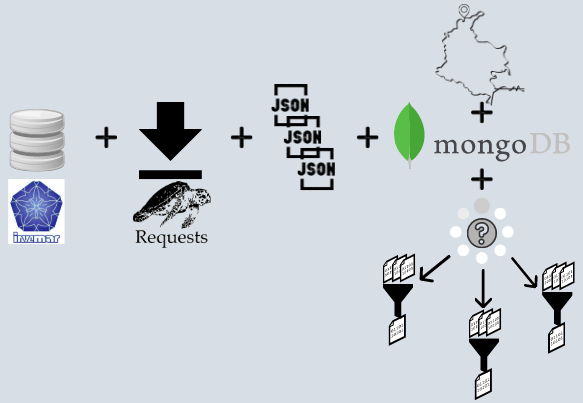
</p>

### 4.1 query planteados
---
Se realizaron operaciones de **agregación** por medio de *pipelines* y operaciones **Map-Reduce** como soporte a la computación en paralelo de grandes volúmenes de datos, la implementación de estas herramientas en este caso nos permite plantear búsquedas y query para dar respuesta a las preguntas planteadas al inicio del proyecto.

Las preguntas planteadas son:

1. Desde el punto de vista sedimentológico y litológico, ¿Qué características son relevantes y particulares de la línea litoral del Caribe Colombiano?

3. ¿Cuales son las Unidades Geomorfológicas más relevantes de la Costa Caribe Colombiana?

4. ¿Cuales son las litofacies predominantes de la plataforma proximal del Caribe colombiano?

In [ ]:
# Módulo bson (Binary JSON) para plantear los query
import bson
from bson.son import SON

#### 4.1.1 Pregunta 1
---
Desde el punto de vista sedimentológico y litológico, ¿Qué características son relevantes y particulares de la línea litoral del Caribe Colombiano?

In [ ]:
#calculamos la longitud total de los tipos de costa
# Función MAP
mapper = bson.Code(
"""
function map() {    
    emit('total_length', this.properties.Shape_Leng)
  }   
""")

# Función REDUCE

reducer = bson.Code(
"""
function reduce(key, values) {
  return Array.sum(values)
}    
""")

map_reduce_result = db.Coast_type.map_reduce(mapper, 
                                          reducer, 
                                          'thing_sum')

map_reduce_result

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'carib'), 'thing_sum')

In [ ]:
for result in map_reduce_result.find():
  print(result)
  tot= result['value']

tot

{'_id': 'total_length', 'value': 2319792.4047883167}


2319792.4047883167

In [ ]:
#proporción de tipos de depósitos en costa caribe
pipeline = [{"$unwind": "$properties.geologico"},
            {"$group": {"_id": "$properties.geologico", 
                        "count": {"$sum": 1}, 
                        "length":{"$sum":"$properties.Shape_Leng"}}},
            {"$project": {"percent": {"$multiply": [{"$divide":["$length", tot]}, 100]}}},
            {"$sort": SON([("percent", -1), ("_id", -1)])}]

df_deposits = pd.DataFrame(db.Coast_type.aggregate(pipeline))
df_deposits

,_id,percent
0,Depositos lacustres,32.386672
1,Depositos marinos,14.446272
2,Depositos aluviales,11.218470
3,Rocas sedimentarias terrigenas,11.030388
4,Depositos fluviomarinos,8.000013
5,Depositos eolicos,7.159907
6,Rocas sedimentarias calcareas,7.144527
7,Rocas metamorficas,4.333400
8,Rocas igneas volcanicas,2.034443
9,Rocas igneas intrusivas,1.192220


In [ ]:
df_deposits['percent'].sum()

99.99999999999996

El paradiga MapReduce es útil a la hora de calcular la lingitud total

In [ ]:
#proporción de tipos de geomorfología en costa caribe
pipeline = [{"$unwind": "$properties.geomorf"},
            {"$group": {"_id": "$properties.geomorf", 
                        "count": {"$sum": 1},
                        "length":{"$sum":"$properties.Shape_Leng"}}},
            {"$project": {"percent": {"$multiply": [{"$divide":["$length", tot]}, 100]}}},
            {"$sort": SON([("percent", -1), ("_id", -1)])}]

df_geomorf = pd.DataFrame(db.Coast_type.aggregate(pipeline))
df_geomorf

,_id,percent
0,Playas,30.481094
1,Costas lodosas,20.260873
2,Sistemas deltaicos,18.493424
3,Rocas cohesivas,15.380423
4,Rocas no cohesivas,10.036787
5,Costas Ubanizadas,5.347398


In [ ]:
df_geomorf['percent'].sum()

99.99999999999996

#### 4.1.2 Pregunta 2
---
¿Cuales son las Unidades Geomorfológicas más relevantes de la Costa Caribe Colombiana?

In [ ]:
#calculamos el área total de las unidades geomorfológicas
# Función MAP
mapper = bson.Code(
"""
function map() {    
    emit('total_area', this.properties.Shape_Area)
  }   
""")

# Función REDUCE

reducer = bson.Code(
"""
function reduce(key, values) {
  return Array.sum(values)
}    
""")

map_reduce_result2 = db.Coast_geomrf.map_reduce(mapper, 
                                          reducer, 
                                          'thing_sum')

map_reduce_result2

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'carib'), 'thing_sum')

In [ ]:
for item in map_reduce_result2.find():
  print(item)
  tot2 = item['value']
tot2

{'_id': 'total_area', 'value': 6778565003.54869}


6778565003.54869

In [ ]:
#proporción de Unidades geomorfológicas en costa caribe
pipeline = [{"$unwind": "$properties.GEOMFLGIA_"},
            {"$group": {"_id": "$properties.GEOMFLGIA_", 
                        "count": {"$sum": 1}, 
                        "area":{"$sum":"$properties.Shape_Area"}}},
            {"$project": {"percent": {"$multiply": [{"$divide":["$area", tot2]}, 100]}}},
            {"$sort": SON([("percent", -1), ("_id", -1)])}]

df_geomrf = pd.DataFrame(db.Coast_geomrf.aggregate(pipeline))
df_geomrf

,_id,percent
0,Pantano de manglar,18.000784
1,Colinas y montañas,16.859111
2,Laguna Costera,15.655898
3,Llanura costera,8.301484
4,Valle aluvial,7.575254
5,Salares y zonas de inundacion,5.577005
6,Llanura aluvial,4.496221
7,Plataforma de abrasion elevada,3.803277
8,Area urbana,3.145804
9,Playones,2.533988


In [ ]:
df_geomrf['percent'].sum()

99.99999999999996

#### 4.1.4 Pregunta 3
---
¿Cuales son las litofacies predominantes de la plataforma proximal del Caribe colombiano?

In [ ]:
#calculamos el área total de las facies sedimentológicas
# Función MAP
mapper = bson.Code(
"""
function map() {    
    emit('total_area', this.properties.Shape_Area)
  }   
""")

# Función REDUCE

reducer = bson.Code(
"""
function reduce(key, values) {
  return Array.sum(values)
}    
""")

map_reduce_result3 = db.Coast_facies.map_reduce(mapper, 
                                          reducer, 
                                          'thing_sum')

map_reduce_result3

Collection(Database(MongoClient(host=['localhost:27017'], document_class=dict, tz_aware=False, connect=True), 'carib'), 'thing_sum')

In [ ]:
for item in map_reduce_result3.find():
  print(item)
  tot3 = item['value']
tot3

{'_id': 'total_area', 'value': 33180766134.420334}


33180766134.420334

In [ ]:
pipeline = [{"$unwind": "$properties.FACIES"},  
            {"$group": {"_id": "$properties.FACIES", 
                        "count": {"$sum": 1}, 
                        "area":{"$sum":"$properties.Shape_Area"}}},
            {"$project": {"percent": {"$multiply": [{"$divide":["$area", tot3]}, 100]}}},
            {"$sort": SON([("percent", -1), ("_id", -1)])}]

df_facies = pd.DataFrame(db.Coast_facies.aggregate(pipeline))
df_facies

,_id,percent
0,LODO LITOCLASTICO,34.830962
1,ARENA BIOLITOCLASTICA,12.488155
2,LODO LITOBIOCLASTICO,7.317955
3,LODO ARENOSO LITOBIOCLASTICO,7.160782
4,ARENA LODOSA LITOBIOCLASTICA,6.821513
5,ARENA LODOSA BIOLITOCLASTICA,6.532053
6,LODO ARENOSO LITOCLASTICO,6.470409
7,ARENA BIOCLASTICA,5.480715
8,ARENA LITOBIOCLASTICA,4.871616
9,ARENA LODOSA LITOCLASTICA,3.651441


In [ ]:
df_facies['percent'].sum()

100.00000000000006

### 4.2 Visualización de los datos
---
Se utilizaron diagramas de barras junto con representaciones geográficas para ilustrar las características encontradas durante el proyecto, por medio de las librerías de python: **matplolib**, **seaborn** y **plotly**, fue posible la visualización de los datos y relaciones filtradas o derivadas a través de los query planteados.

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

#### 4.2.1 Sedimentología y litología
---

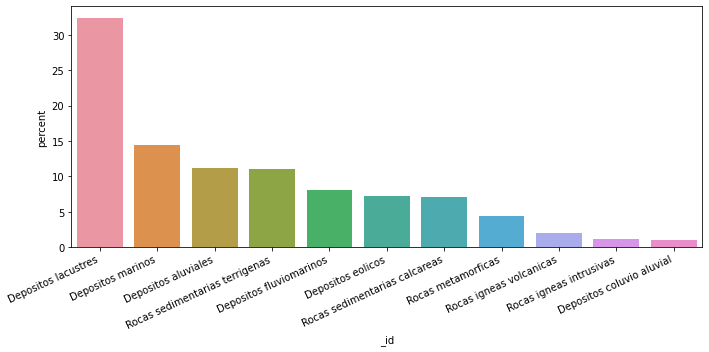

In [ ]:
fig = plt.figure(figsize=(10, 5))
fig = sns.barplot(x=df_deposits['_id'],y=df_deposits['percent'])
plt.xticks(rotation=25, ha='right')
plt.tight_layout();

In [ ]:
df = pd.DataFrame(db.Coast_type.find({},{"geometry.coordinates":1, "properties.geologico":1, "properties.geomorf":1}))

latitud = []
longitud = []
geolo = []
geomorf = []

c = ['DarkGoldenRod', 'Orange', 'PowderBlue', 
     'aquamarine', 'YellowGreen', 'Red', 'Brown',
     'black', 'SpringGreen', 'blue', 'blueviolet']

color = {}

for i, item in enumerate(df_deposits['_id']):
  color[item] = c[i]

for i in range(len(df.geometry)):
  lat, lon = [], []
  geom = df.geometry[i]['coordinates']
  name_geol = df.properties[i]['geologico']
  name_gemorf = df.properties[i]['geomorf']

  for item in geom[0]:
    x, y = item
    lat.append(y)
    lon.append(x)
    
  geolo.append(name_geol)
  geomorf.append(name_gemorf)  
  latitud.append(lat)
  longitud.append(lon)

In [ ]:
import plotly.graph_objects as go

set_curve = set()

fig = go.Figure()
for i, item in enumerate(geolo):
  fig.add_trace(go.Scattergeo(locationmode = 'USA-states',
                     lon = longitud[i], lat = latitud[i],
                     text = item,
                     name = item,
                     showlegend=False if item in set_curve else True,
                     mode = 'lines', line = dict(width = 1, color=color[item])
                           )    
              )
  set_curve.add(item)

fig.update_layout(title = dict(text = 'Costa Caribe Colombiana - Litología'),
              xaxis= dict(title_text='longitud'),
              geo = dict(scope = 'world', showland = True, 
                         landcolor = "rgb(212, 212, 212)", #color de la tierra
                         subunitcolor = "rgb(255, 255, 255)", 
                         countrycolor = "rgb(255, 255, 255)", #color de los bordes paises
                         showlakes = True, lakecolor = "rgb(255, 255, 255)", 
                         showsubunits = True, #color de los lagor
                         showcountries = True, resolution = 50, 
                         showocean = True, oceancolor = '#79C8E5', #color del océano
                         projection = dict(type = 'orthographic', 
                                           rotation_lon = -75), #tipo de proyeccion y centrado en 20° por rotación
                         lonaxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[-110, -100], dtick = 5), #rango de visulización long
                         lataxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[7, 13], dtick = 5) #rango de visulización lat
                         )
              ) 
                         # antes de definir el range de lonaixs debe definir bien el rotation_lon
fig.show()
fig.write_html("/content/Costa-Carib-geolo.html")

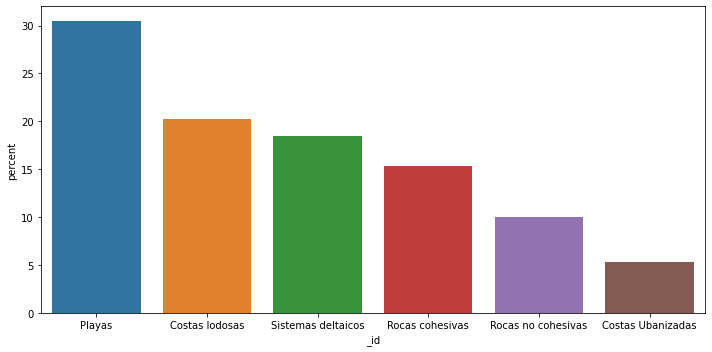

In [ ]:
fig = plt.figure(figsize=(10, 5))
fig = sns.barplot(x=df_geomorf['_id'],y=df_geomorf['percent'])
plt.xticks(rotation=0)
plt.tight_layout();

In [ ]:
latitud = []
longitud = []
geomorf = []

c = ['DarkGoldenRod', 'Orange', 'PowderBlue', 
     'aquamarine', 'YellowGreen', 'Red', 'Brown',
     'black', 'SpringGreen', 'blue', 'blueviolet']

color = {}

for i, item in enumerate(df_geomorf['_id']):
  color[item] = c[i]

for i in range(len(df.geometry)):
  lat, lon = [], []
  geom = df.geometry[i]['coordinates']
  name_geol = df.properties[i]['geologico']
  name_gemorf = df.properties[i]['geomorf']

  for item in geom[0]:
    x, y = item
    lat.append(y)
    lon.append(x)
    
  geolo.append(name_geol)
  geomorf.append(name_gemorf)  
  latitud.append(lat)
  longitud.append(lon)

In [ ]:
set_curve = set()

fig = go.Figure()
for i, item in enumerate(geomorf):
  fig.add_trace(go.Scattergeo(locationmode = 'USA-states',
                     lon = longitud[i], lat = latitud[i],
                     text = item,
                     name = item,
                     showlegend=False if item in set_curve else True,
                     mode = 'lines', line = dict(width = 1, color=color[item])
                           )    
              )
  set_curve.add(item)

fig.update_layout(title = dict(text = 'Costa Caribe Colombiana - Geomorfología'),
              xaxis= dict(title_text='longitud'),
              geo = dict(scope = 'world', showland = True, 
                         landcolor = "rgb(212, 212, 212)", #color de la tierra
                         subunitcolor = "rgb(255, 255, 255)", 
                         countrycolor = "rgb(255, 255, 255)", #color de los bordes paises
                         showlakes = True, lakecolor = "rgb(255, 255, 255)", 
                         showsubunits = True, #color de los lagor
                         showcountries = True, resolution = 50, 
                         showocean = True, oceancolor = '#79C8E5', #color del océano
                         projection = dict(type = 'orthographic', 
                                           rotation_lon = -75), #tipo de proyeccion y centrado en 20° por rotación
                         lonaxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[-110, -100], dtick = 5), #rango de visulización long
                         lataxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[7, 13], dtick = 5) #rango de visulización lat
                         )
              ) 
                         # antes de definir el range de lonaixs debe definir bien el rotation_lon
fig.show()
fig.write_html("/content/Costa-Carib-geomorf.html")

#### 4.2.2 Geomorfología
---

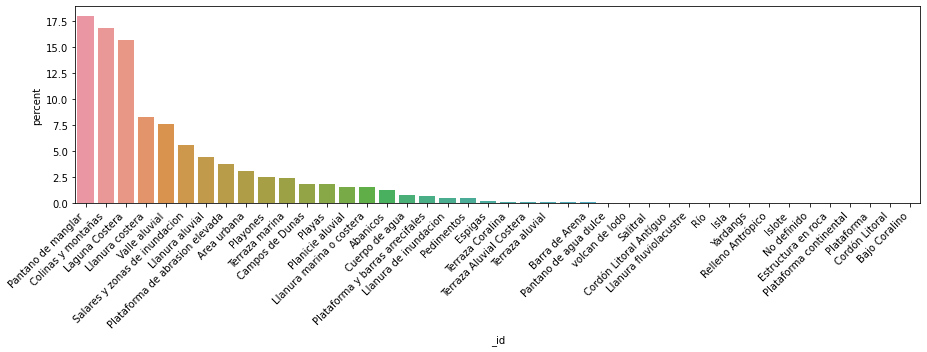

In [ ]:
fig = plt.figure(figsize=(13, 5))
fig = sns.barplot(x=df_geomrf['_id'],y=df_geomrf['percent'])
plt.xticks(rotation=45, ha='right')
plt.tight_layout();

In [ ]:
df1 = pd.DataFrame(db.Coast_geomrf.find({},{"geometry.coordinates":1, "properties.GEOMFLGIA_":1}))

latitud = []
longitud = []
geomorf = []

c = ['DarkGoldenRod', 'Orange', 'PowderBlue', 
     'aquamarine', 'YellowGreen', 'Red', 'Brown',
     'black', 'SpringGreen', 'blue', 'blueviolet', 'LightSalmon',
     'chocolate', 'saddlebrown', 'sienna', 'brown', 'maroon', 'lightpink', 'hotpink', 
     'deeppink', 'magenta', 'mediumorchid', 'mediumpurple', 'blueviolet', 'darkviolet', 
     'deepskyblue', 'lightsteelblue', 'dodgerblue', 'cornflowerblue', 'steelblue', 
     'palegreen', 'darkseagreen', 'mediumseagreen', 'seagreen', 'khaki', 'darkkhaki', 'yellow',
     'orangered', 'gold', 'orange', 'darkorange', 'salmon']

color = {}

for i, item in enumerate(df_geomrf['_id']):
  color[item] = c[i]

for i in range(len(df1.geometry)):
  lat, lon = [], []
  geom = df1.geometry[i]['coordinates']
  #name_geol = df.properties[i]['geologico']
  name_gemorf = df1.properties[i]['GEOMFLGIA_']

  for item in geom[0][0]:
    x, y = item
    lat.append(y)
    lon.append(x)
    
  #geolo.append(name_geol)
  geomorf.append(name_gemorf)  
  latitud.append(lat)
  longitud.append(lon)

In [ ]:
set_curve = set()

fig = go.Figure()
for i, item in enumerate(geomorf):
  fig.add_trace(go.Scattergeo(locationmode = 'USA-states',
                     lon = longitud[i], lat = latitud[i],
                     text = item,
                     name = item,
                     showlegend=False if item in set_curve else True,
                     mode = 'lines', line = dict(width = 1, color=color[item]),
                     fill= "toself",
                     fillcolor = color[item]
                           )    
              )
  set_curve.add(item)

fig.update_layout(title = dict(text = 'Costa Caribe Colombiana - Geomorfología'),
              xaxis= dict(title_text='longitud'),
              geo = dict(scope = 'world', showland = True, 
                         landcolor = "rgb(212, 212, 212)", #color de la tierra
                         subunitcolor = "rgb(255, 255, 255)", 
                         countrycolor = "rgb(255, 255, 255)", #color de los bordes paises
                         showlakes = True, lakecolor = "rgb(255, 255, 255)", 
                         showsubunits = True, #color de los lagos
                         showcountries = True, resolution = 50, 
                         showocean = True, oceancolor = '#79C8E5', #color del océano
                         projection = dict(type = 'orthographic', 
                                           rotation_lon = -75), #tipo de proyeccion y centrado en 20° por rotación
                         lonaxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[-110, -100], dtick = 5), #rango de visulización long
                         lataxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[7, 13], dtick = 5) #rango de visulización lat
                         )
              ) 
                         # antes de definir el range de lonaixs debe definir bien el rotation_lon
fig.show()
fig.write_html("/content/Costa-Carib-poly.html")

#### 4.2.3 Facies sedimentarias
---

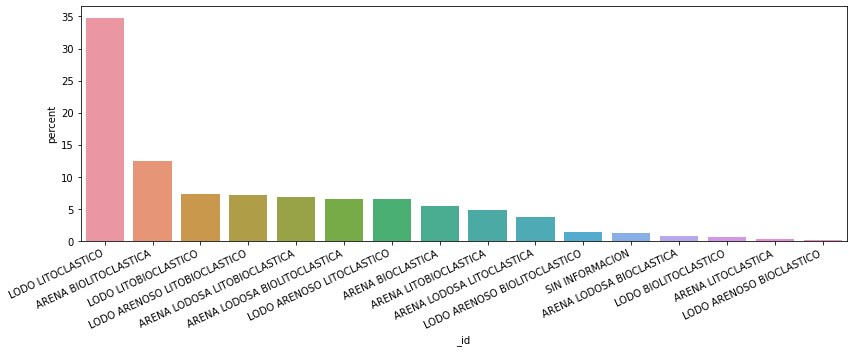

In [ ]:
fig = plt.figure(figsize=(12, 5))
fig = sns.barplot(x=df_facies['_id'],y=df_facies['percent'])
plt.xticks(rotation=25, ha='right')
plt.tight_layout();

In [ ]:
df2 = pd.DataFrame(db.Coast_facies.find({},{"geometry.coordinates":1, "properties.FACIES":1}))

latitud = []
longitud = []
facies = []

c = ['DarkGoldenRod', 'Orange', 'PowderBlue', 
     'aquamarine', 'YellowGreen', 'Red', 'Brown',
     'black', 'SpringGreen', 'blue', 'blueviolet', 'LightSalmon',
     'chocolate', 'saddlebrown', 'sienna', 'brown']

color = {}

for i, item in enumerate(df_facies['_id']):
  color[item] = c[i]

for i in range(len(df2.geometry)):
  lat, lon = [], []
  geom = df2.geometry[i]['coordinates']
  #name_geol = df.properties[i]['geologico']
  name_facies = df2.properties[i]['FACIES']

  for item in geom[0][0]:
    x, y = item
    lat.append(y)
    lon.append(x)
    
  #geolo.append(name_geol)
  facies.append(name_facies)  
  latitud.append(lat)
  longitud.append(lon)

In [ ]:
set_curve = set()

fig = go.Figure()
for i, item in enumerate(facies):
  fig.add_trace(go.Scattergeo(locationmode = 'USA-states',
                     lon = longitud[i], lat = latitud[i],
                     text = item,
                     name = item,
                     showlegend=False if item in set_curve else True,
                     mode = 'lines', line = dict(width = 1, color=color[item]),
                     fill= "toself",
                     fillcolor = color[item]
                           )    
              )
  set_curve.add(item)

fig.update_layout(title = dict(text = 'Costa Caribe Colombiana - Geomorfología'),
              xaxis= dict(title_text='longitud'),
              geo = dict(scope = 'world', showland = True, 
                         landcolor = "rgb(212, 212, 212)", #color de la tierra
                         subunitcolor = "rgb(255, 255, 255)", 
                         countrycolor = "rgb(255, 255, 255)", #color de los bordes paises
                         showlakes = True, lakecolor = "rgb(255, 255, 255)", 
                         showsubunits = True, #color de los lagos
                         showcountries = True, resolution = 50, 
                         showocean = True, oceancolor = '#79C8E5', #color del océano
                         projection = dict(type = 'orthographic', 
                                           rotation_lon = -75), #tipo de proyeccion y centrado en 20° por rotación
                         lonaxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[-110, -100], dtick = 5), #rango de visulización long
                         lataxis = dict(showgrid = True, gridwidth = 0.5,
                                        range=[7, 13], dtick = 5) #rango de visulización lat
                         )
              ) 
                         # antes de definir el range de lonaixs debe definir bien el rotation_lon
fig.show()
fig.write_html("/content/Costa-Carib-facies.html")

## 5. Conclusiones
---
* Los resultados obtenidos en este proyecto muestran que el 32.4% de los depósitos localizados en la línea de costa son de tipo lacustre, mientra que el 14.4% son de tipo marino, esto junto al hecho que el 30.5% de estos depósitos son playas y el 20.3% son Costas lodosas permite inferir que los procesos geomorfológicos que han modelado la costa caribe son de baja energía ya que los sedimentos lodosos obedecen a agentes que sólo pueden acumular particulas de tamaño fino.

* Adicionalmente, desde el punto de vista geomorfológico el 18% de las Unidades geomorfológicas que dominan en el Caribe colombiano son de tipo Pantano de manglar y el 16.9% corresponden a Colinas y montañas. Este resultado es muy congruente con las facies sedimentarias predominantes en la plataforma proximal donde el 34.8% es Lodo litoclástico y 12.5% Arena biolitoclástica.

* La predominante presencia de Pantanos de manglar se explica debido a la preferencia que tiene estos organismos por fondos lodosos para asentarse, por lo que es posible que sean una consecuencia de los mismos procesos geomorfológicos que han concentrado dichos sedimentos de grano fino. Ademas, el carácter litoclástico de las facies predominantes se puede atribuir a la influencia fluvial de ríos de gran caudal como el Magdalena, cuya desembocadura se encuentra en Bocas de Ceniza (Barranquilla), y a la presencia de un relieve (fuente de litoclastos) señalado por la predominancia de Colinas y montañas (erosionables), esto permiten señalar la influencia de la actividad tectónica que aumentó el relieve en esta zona, causando la erosión del mismo. Dado que actualmente la actividad tectónica de la Costa Caribe es muy baja, es posible afirmar que los procesos que modelaron el relieve costero cesaron en algún momento de la historia geológica.

## Bibliografía
---
* SIAM-INVEMAR. (19 de agosto, 2016). *DAMCRA-Facies* [Base de datos]. Recuperado de la base de datos de http://geonodesiam.invemar.org.co/layers/geonode%3Afacies_1#more

* SIAM-INVEMAR. (19 de agosto, 2016). *DAMCRA-Mapa Geomorfológico del caribe colombiano* [Base de datos]. Recuperado de la base de datos de http://geonodesiam.invemar.org.co/layers/geonode%3Ageomorfologia_4

* SIAM-INVEMAR. (19 de agosto, 2016). *DAMCRA-Tipos de Costas* [Base de datos]. Recuperado de la base de datos de http://geonodesiam.invemar.org.co/layers/geonode%3Atipos_de_costa

